# Visualizing the node and edge features in maps

- Visualizations in Figure 1.
- Node and edge visualizations in SI.


In [5]:
import numpy as np
import pandas as pd
import geopandas as gpd
import networkx as nx
import matplotlib.pyplot as plt
import pickle
import copy
import scipy.sparse as sp
from scipy.sparse import csr_matrix
from sklearn.linear_model import LinearRegression
# regression tools
import statsmodels.api as sm
from sklearn.preprocessing import normalize
from sklearn.preprocessing import StandardScaler

In [6]:
import contextily as ctx

In [3]:
import sys
sys.path.append("../")

In [4]:
import utils

In [7]:
# read boston
with open("../../data/02_intermediate/boston_stays.pickle", 'rb') as f:
    boston_stays = pickle.load(f)

In [8]:
# read files
with open("../../data/02_intermediate/socioecon_boston_miami_chicago_nyc_ct_shp_dic.pickle", 'rb') as f:
    socioecon_shp_dic = pickle.load(f)


In [9]:
# hetero activity graphs    
with open("../../data/03_processed/A_home_activity_three_cities_unweighted_dic.pickle", 'rb') as f:
    A_home_unweighted_dic = pickle.load(f)

with open("../../data/03_processed/A_home_activity_three_cities_weighted_dic.pickle", 'rb') as f:
    A_home_weighted_dic = pickle.load(f)
    

In [10]:
with open("../../data/03_processed/A_home_activity_unweighted_sym_adj_dic.pickle", 'rb') as f:
    A_home_unweighted_sym_dic = pickle.load(f)


In [9]:
# with open("../../data/03_processed/A_home_activity_unweighted_sym_adj_boston_dic.pickle", 'wb') as f:
#     pickle.dump(A_home_unweighted_sym_dic['boston'][1.0], f)

In [10]:
# with open("../../data/03_processed/boston_socioecon_shp.pickle", 'wb') as f:
#     pickle.dump(socioecon_shp_dic['boston'], f)


In [11]:
# read edge file
with open("../../data/02_intermediate/edge_shp_dic.pickle", 'rb') as f:
    edge_shp_dic = pickle.load(f)

In [12]:
# read spatial network dic
with open("../../data/03_processed/spatial_network_boston_miami_chicago_dic.pickle", 'rb') as f:
    spatial_network_dic = pickle.load(f)


In [13]:
# save path
fig_location = '../../../economic-strength-of-weak-mobility-ties-paper-/figs/'

### Visualizing the economic nodes, and strong vs. weak ties (Fig 1)

In [ ]:
# choose the city
city = 'boston'
df_shp = socioecon_shp_dic[city]

In [ ]:
# find the ct with the largest visits to french restaurants
strong_tie_name = 'Office'
weak_tie_name = 'French'
weak_vector_counts = A_home_unweighted_sym_dic[city][1.0]['French'].sum(axis=1).sort_values(ascending = False)
top_ct = weak_vector_counts.index[0]
print(top_ct)

In [ ]:
# find the central lon and lat for visualization
center_lon = socioecon_shp_dic[city].loc[top_ct, 'geometry'].centroid.x # lon
center_lat = socioecon_shp_dic[city].loc[top_ct, 'geometry'].centroid.y # lat
print(center_lon)
print(center_lat)

# create the central point for visualization
from shapely.geometry import Point

half_width = 0.02
half_height = 0.015
point_left_up = Point(center_lon-half_width, center_lat+half_height) # lon & lat
point_right_down = Point(center_lon+half_width, center_lat-half_height) # lon & lat
box_4269 = gpd.GeoSeries([point_left_up, point_right_down], crs = 'epsg:4269')
box_3857 = box_4269.to_crs(epsg=3857)
xlim_3857 = (box_3857[0].x, box_3857[1].x)
ylim_3857 = (box_3857[1].y, box_3857[0].y)
print(xlim_3857)
print(ylim_3857)


In [212]:
# find the census tracts within a visualization range.
half_visual_width = half_width * 1.2
half_visual_height = half_height * 1.2

lon_condition = np.logical_and(center_lon - half_visual_width < socioecon_shp_dic[city].loc[:, 'geometry'].centroid.x,
               socioecon_shp_dic[city].loc[:, 'geometry'].centroid.x < center_lon + half_visual_width)
lat_condition = np.logical_and(center_lat - half_visual_height < socioecon_shp_dic[city].loc[:, 'geometry'].centroid.y,
               socioecon_shp_dic[city].loc[:, 'geometry'].centroid.y < center_lat + half_visual_height)
ct_in_range_condition = np.logical_and(lon_condition, lat_condition)
print(np.sum(ct_in_range_condition))

# create a list of cts for edge visualization
ct_in_range_list = list(ct_in_range_condition.loc[ct_in_range_condition == True].index) 


/home/jtl/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  """
/home/jtl/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  
/home/jtl/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  import sys
/home/jtl/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project 

270


In [213]:
# choose the boston stays in the lon and lat range.
# let's use boston as an example! 
boston_stays_sub = boston_stays.loc[np.logical_and(boston_stays.lon_medoid < center_lon+half_width,
                                                   boston_stays.lon_medoid > center_lon-half_width), :]
boston_stays_sub = boston_stays_sub.loc[np.logical_and(boston_stays.lat_medoid < center_lat+half_width,
                                                   boston_stays.lat_medoid > center_lat-half_width), :]

# random sampling to facilitate visualization
sampling_ratio = 0.1
print(boston_stays_sub.shape)
boston_stays_sub = boston_stays_sub.loc[np.random.choice(boston_stays_sub.index, 
                                                         size = int(boston_stays_sub.shape[0]*sampling_ratio),
                                                         replace = False), :]
print(boston_stays_sub.shape)

# create the gpd
boston_stays_sub_gpd = gpd.GeoDataFrame(boston_stays_sub, 
                                        geometry=gpd.points_from_xy(boston_stays_sub.lon_medoid, boston_stays_sub.lat_medoid), 
                                        crs = 'epsg:4269')

boston_stays_sub_gpd_3857 = boston_stays_sub_gpd.to_crs(epsg=3857)


(3419610, 18)
(341961, 18)


In [215]:
# Choose only eight activities to facilitate visualization.
activity_list = ['Office','Residential','Automotive','Church','Cycle Studio','New American','French','Art Museum']
boston_stays_sub_gpd_3857 = boston_stays_sub_gpd_3857.loc[boston_stays_sub_gpd_3857.cat.isin(activity_list), :]

cmap = plt.cm.get_cmap('Spectral') # use this cmap
color_dict = {'Office':cmap(0.1),
              'Residential':cmap(0.2),
              'Automotive':cmap(0.3),
              'Church':cmap(0.4),
              'Cycle Studio':cmap(0.5),
              'New American':cmap(0.6),
              'French':cmap(0.7),
              'Art Museum':cmap(0.8)}

print(boston_stays_sub_gpd_3857.shape)

(45972, 19)


In [216]:
# concat the strong and weak tie counts to the df.
strong_tie_col = pd.DataFrame(A_home_unweighted_sym_dic[city][1.0][strong_tie_name].sum(axis=1), 
                              columns = [strong_tie_name])
weak_tie_col = pd.DataFrame(A_home_unweighted_sym_dic[city][1.0][weak_tie_name].sum(axis=1), 
                              columns = [weak_tie_name])

df_shp = pd.concat([df_shp, strong_tie_col], axis = 1)
df_shp = pd.concat([df_shp, weak_tie_col], axis = 1)
df_shp = df_shp.fillna(value = 0.0)
df_shp

,STATEFP,COUNTYFP,TRACTCE,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,...,vehicle_per_capita_2016,vehicle_per_household_2016,vacancy_ratio_2016,inc_per_capita_annual_growth,pop_total_annual_growth,property_value_median_annual_growth,pop_density_2018,pop_density_2016,Office,French
25009201100,25,009,201100,2011,Census Tract 2011,G5020,S,2786306,3481257,+42.4282342,...,0.540478,1.172500,0.078341,0.06139,0.00346,0.10509,0.001254,0.001246,49.0,2.0
25009202101,25,009,202101,2021.01,Census Tract 2021.01,G5020,S,1454942,7226,+42.4758943,...,0.511742,1.417344,0.084367,0.05895,0.01663,0.02731,0.001452,0.001405,16.0,2.0
25009202102,25,009,202102,2021.02,Census Tract 2021.02,G5020,S,2919051,24048,+42.4829911,...,0.485313,1.277848,0.054452,0.04425,0.03129,0.01051,0.002280,0.002146,60.0,2.0
25009202200,25,009,202200,2022,Census Tract 2022,G5020,S,3452798,1441782,+42.4695768,...,0.532986,1.385389,0.012953,0.03213,0.00379,0.00856,0.001734,0.001721,58.0,1.0
25009203100,25,009,203100,2031,Census Tract 2031,G5020,S,3720285,1481336,+42.4871332,...,0.473393,1.302447,0.049199,0.02867,0.00736,0.03438,0.001871,0.001844,55.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33017085000,33,017,085000,850,Census Tract 850,G5020,S,120890933,5035519,+43.2155657,...,0.527708,1.397765,0.092628,0.10351,0.01192,0.04965,0.000074,0.000073,32.0,0.0
33017086000,33,017,086000,860,Census Tract 860,G5020,S,126932596,5722104,+43.2753082,...,0.507628,1.440642,0.165501,0.04835,0.00664,0.00590,0.000032,0.000032,20.0,0.0
33017087000,33,017,087000,870,Census Tract 870,G5020,S,94758837,909784,+43.3669235,...,0.453640,1.127822,0.089824,0.09471,0.00417,0.09982,0.000073,0.000072,28.0,0.0
33017088000,33,017,088000,880,Census Tract 880,G5020,S,85593614,3177277,+43.4522291,...,0.523415,1.401166,0.159314,0.04243,0.00566,0.00199,0.000054,0.000054,20.0,0.0


In [217]:
# create the aggregate adj matrix for the next block
agg_adj = pd.DataFrame(np.zeros((A_home_unweighted_sym_dic[city][1.0][strong_tie_name].shape)),
                       columns = A_home_unweighted_sym_dic[city][1.0][strong_tie_name].columns,
                       index = A_home_unweighted_sym_dic[city][1.0][strong_tie_name].index)
for tie_name in A_home_unweighted_sym_dic[city][1.0].keys():
    agg_adj = agg_adj.add(A_home_unweighted_sym_dic[city][1.0][tie_name], fill_value = 0.0)
agg_adj.values[agg_adj.values > 0.0] = 1.0
print(agg_adj)

             25009201100  25009202101  25009202102  25009202200  25009203100  \
25009201100          1.0          1.0          1.0          1.0          1.0   
25009202101          1.0          1.0          1.0          1.0          1.0   
25009202102          1.0          1.0          1.0          1.0          1.0   
25009202200          1.0          1.0          1.0          1.0          1.0   
25009203100          1.0          1.0          1.0          1.0          1.0   
...                  ...          ...          ...          ...          ...   
33017085000          0.0          0.0          0.0          0.0          0.0   
33017086000          0.0          0.0          0.0          0.0          0.0   
33017087000          0.0          0.0          0.0          0.0          0.0   
33017088000          0.0          0.0          0.0          0.0          0.0   
33017088500          0.0          0.0          0.0          0.0          0.0   

             25009203200  25009203301  

In [218]:
# prepare the edges for visualization
# projection
edge_shp = edge_shp_dic[city]
edge_shp_3857 = edge_shp.to_crs(epsg=3857)

# create the agg edges
G_agg = nx.from_pandas_adjacency(agg_adj)
G_agg_edge_df = nx.to_pandas_edgelist(G_agg)
G_agg_edge_df.index = list(zip(G_agg_edge_df['source'], G_agg_edge_df['target']))
G_agg_edge_df = G_agg_edge_df.loc[np.logical_and(G_agg_edge_df.source.isin(ct_in_range_list),G_agg_edge_df.target.isin(ct_in_range_list)),:]

# create the strong edges
G_strong = nx.from_pandas_adjacency(A_home_unweighted_sym_dic[city][1.0][strong_tie_name])
G_strong_edge_df = nx.to_pandas_edgelist(G_strong)
G_strong_edge_df.index = list(zip(G_strong_edge_df['source'], G_strong_edge_df['target']))
G_strong_edge_df = G_strong_edge_df.loc[np.logical_and(G_strong_edge_df.source.isin(ct_in_range_list),G_strong_edge_df.target.isin(ct_in_range_list)),:]

# create the weak edges
G_weak = nx.from_pandas_adjacency(A_home_unweighted_sym_dic[city][1.0][weak_tie_name])
G_weak_edge_df = nx.to_pandas_edgelist(G_weak)
G_weak_edge_df.index = list(zip(G_weak_edge_df['source'], G_weak_edge_df['target']))
G_weak_edge_df = G_weak_edge_df.loc[np.logical_and(G_weak_edge_df.source.isin(ct_in_range_list),G_weak_edge_df.target.isin(ct_in_range_list)),:]


In [219]:
# sampling the edges to improve the visualization quality.
agg_sampling_rate = 0.3
strong_sampling_rate = 0.3
weak_sampling_rate = 0.6

G_agg_edge_df = G_agg_edge_df.loc[np.random.choice(G_agg_edge_df.index, size = int(G_agg_edge_df.shape[0]*agg_sampling_rate), replace=False), :]
G_strong_edge_df = G_strong_edge_df.loc[np.random.choice(G_strong_edge_df.index, size = int(G_strong_edge_df.shape[0]*strong_sampling_rate), replace=False), :]
G_weak_edge_df = G_weak_edge_df.loc[np.random.choice(G_weak_edge_df.index, size = int(G_weak_edge_df.shape[0]*weak_sampling_rate), replace=False), :]

print(G_agg_edge_df.shape)
print(G_strong_edge_df.shape)
print(G_weak_edge_df.shape)


(8302, 3)
(1741, 3)
(251, 3)


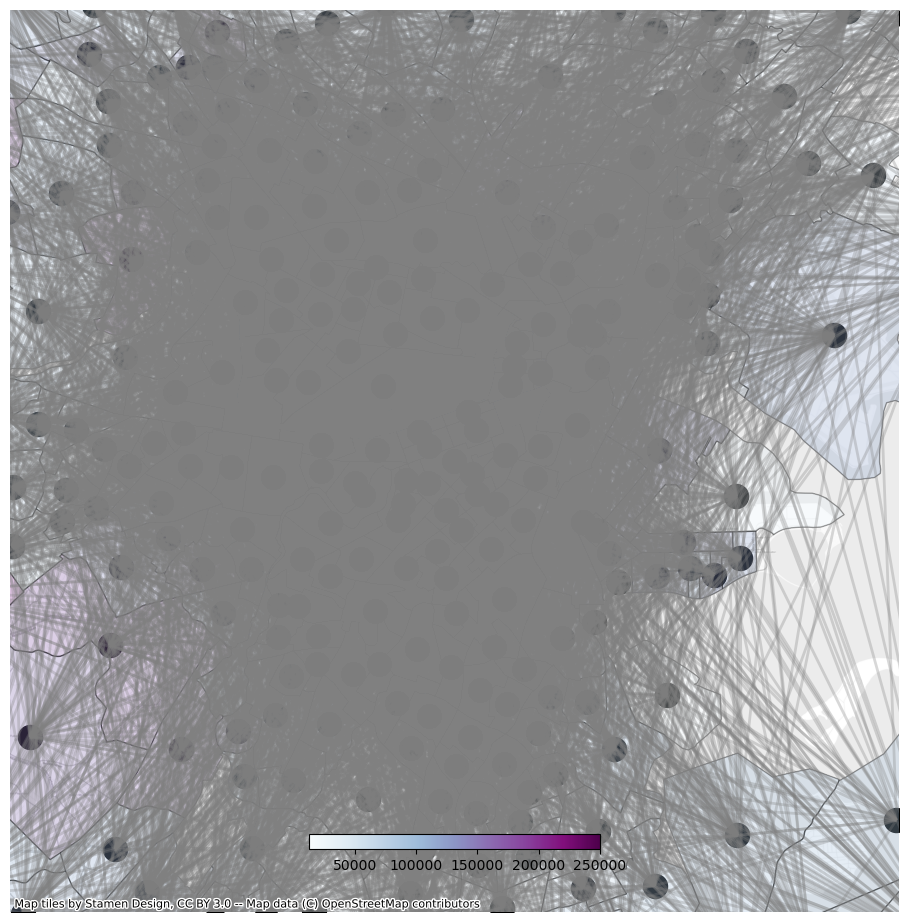

In [220]:
# plot the income & the individuals.
G_edge_df = G_agg_edge_df
target_column = 'inc_median_household_2018'
node_size_scale = 500
alpha = 0.3

df_shp_3857 = df_shp.to_crs(epsg=3857) # Need 3857 to add an web map base. 
fig, ax = plt.subplots(figsize=(10, 10))    
ax.axis('off')

# plot a base
df_shp_3857.plot(facecolor="None", 
                 edgecolor='black', 
                 linewidth=0.1, ax = ax)

# # plot the individuals
# boston_stays_sub_gpd_3857.plot(column='cat', ax = ax, 
#                                markersize = 5, 
#                                legend = True, 
#                                alpha = 0.9,
#                                cmap = colors.ListedColormap(list(color_dict.values())))

# plot agg edges
edge_shp_3857.loc[G_edge_df.index, :].plot(ax = ax, alpha = 0.3, linewidth = 2, color = 'grey')

# plot tie strenght nodes
df_shp_3857.geometry.centroid.plot(markersize = 300, ax = ax, color = 'black')


# plot income nodes
df_shp_3857.plot(column = target_column, 
                 alpha = alpha, 
                 cmap = 'BuPu', # or BuPu
                 ax = ax, 
                 edgecolor='black', 
                 legend=True, legend_kwds={'shrink': 0.3, 'location':'bottom', 'pad':-0.08})


# boston_stays_sub_gpd_3857.plot(markersize = boston_stays_sub_gpd_3857['duration']/node_size_scale, 
#                               color = 'orange',
#                               alpha = 0.05,
#                               ax = ax)

# legend size
params = {'legend.fontsize': 10}
plt.rcParams.update(params)

ax.set_xlim(xlim_3857)
ax.set_ylim(ylim_3857)

ctx.add_basemap(ax, zoom = 15, 
                source=ctx.providers.Stamen.TonerLite,
                alpha = 0.5) # smaller zoom shows larger words. 
# https://contextily.readthedocs.io/en/latest/providers_deepdive.html

plt.tight_layout()
plt.show()


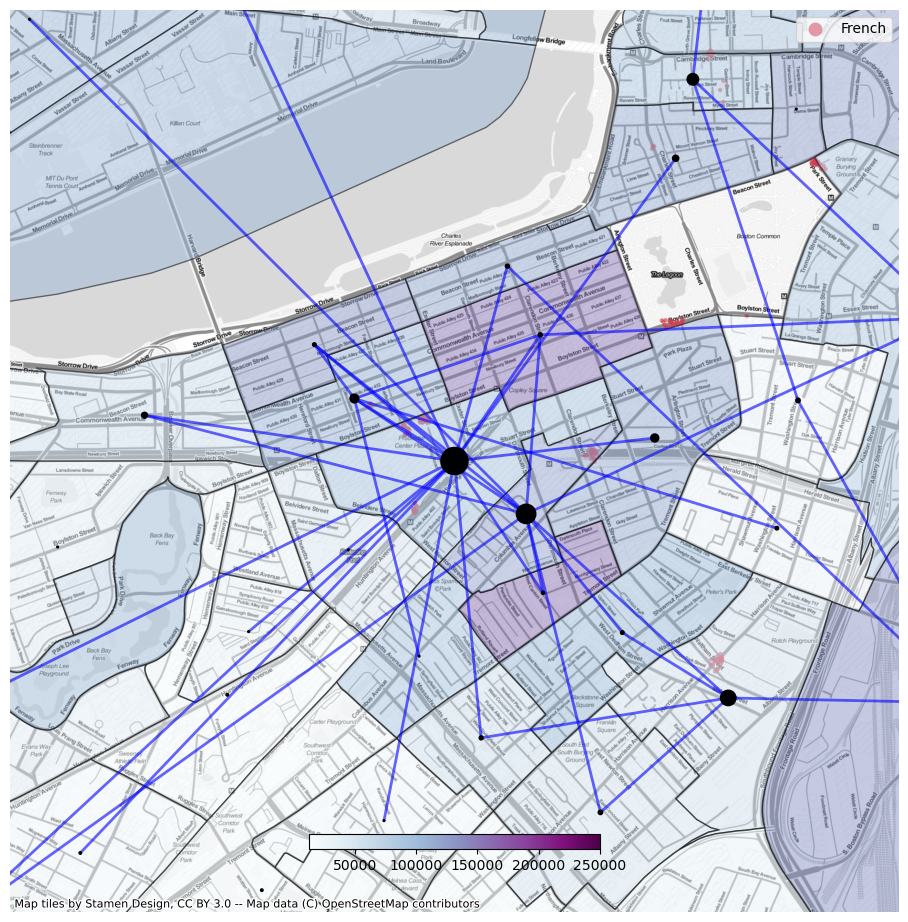

In [196]:
# Plot the weak networks
G_edge_df = G_weak_edge_df
tie_name = weak_tie_name
node_size_scale = 0.6
alpha = 0.5
edge_color = 'blue' # french restaurant color

target_column = 'inc_median_household_2018'
# output_list = ['inc_median_household_2018', 'property_value_median_2018', 'rent_median_2018']
# title_name = 'inc'
alpha = 0.5

df_shp_3857 = df_shp.to_crs(epsg=3857) # Need 3857 to add an web map base. 
fig, ax = plt.subplots(figsize=(10, 10))    
ax.axis('off')

# plot the individuals
boston_stays_sub_gpd_3857.loc[boston_stays_sub_gpd_3857.cat == weak_tie_name,:].plot(column='cat', ax = ax, 
                               markersize = 5, legend = True, 
                               alpha = alpha,
                               cmap = colors.ListedColormap(list(color_dict.values())))

# plot a base
df_shp_3857.plot(facecolor="None", edgecolor='grey', linewidth=0.1, ax = ax)

# plot income nodes
df_shp_3857.plot(column = target_column, alpha = alpha, cmap = 'BuPu', 
                 ax = ax, edgecolor='black', 
                 legend=True, legend_kwds={'shrink': 0.3, 'location':'bottom', 'pad':-0.08})

# plot strong edges
edge_shp_3857.loc[G_edge_df.index, :].plot(ax = ax, alpha = 0.6, linewidth = 2, color = edge_color, zorder=1)

# plot tie strenght nodes
df_shp_3857.geometry.centroid.plot(markersize = df_shp_3857[tie_name]/node_size_scale, ax = ax, color = 'black', zorder=2)

#     for x, y, label in zip(df_shp_3857.geometry.centroid.x, df_shp_3857.geometry.centroid.y, df_shp_3857[target_column]):
#         ax.annotate(label, xy=(x, y))#, xytext=(3, 3), textcoords="offset points")
# if xlim is not None and ylim is not None:

# legend size
params = {'legend.fontsize': 10}
plt.rcParams.update(params)

ax.set_xlim(xlim_3857)
ax.set_ylim(ylim_3857)
# ax.set_title(title_name, fontsize=18)

ctx.add_basemap(ax, zoom = 16, source=ctx.providers.Stamen.TonerLite) # smaller zoom shows larger words. 
# https://contextily.readthedocs.io/en/latest/providers_deepdive.html

plt.tight_layout()
plt.show()


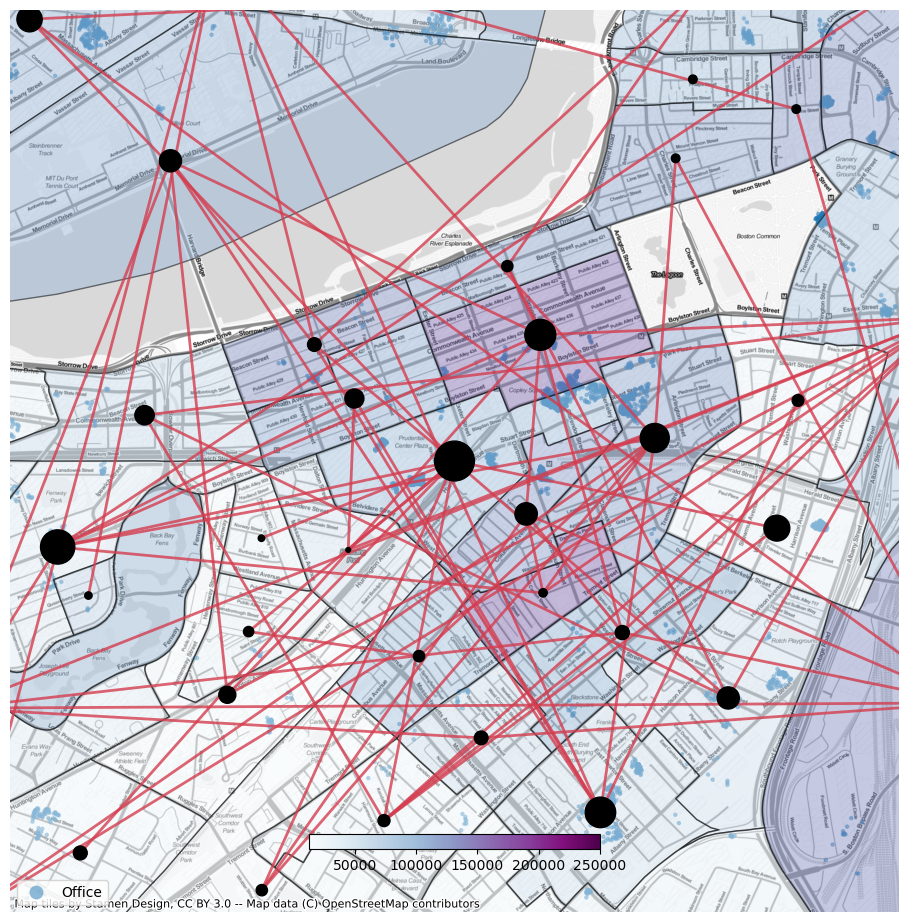

In [193]:
# Plot the strong networks
G_edge_df = G_strong_edge_df
tie_name = strong_tie_name
node_size_scale = 0.6
edge_color = color_dict[strong_tie_name] # residential color

target_column = 'inc_median_household_2018'
# output_list = ['inc_median_household_2018', 'property_value_median_2018', 'rent_median_2018']
# title_name = 'inc'
alpha = 0.5

df_shp_3857 = df_shp.to_crs(epsg=3857) # Need 3857 to add an web map base. 
fig, ax = plt.subplots(figsize=(10, 10))    
ax.axis('off')

# plot the individuals
boston_stays_sub_gpd_3857.loc[boston_stays_sub_gpd_3857.cat == strong_tie_name,:].plot(column='cat', ax = ax, 
                               markersize = 5, legend = True, 
                               alpha = alpha,
                               c = edge_color)


# plot a base
df_shp_3857.plot(facecolor="None", edgecolor='grey', linewidth=0.1, ax = ax)

# plot income nodes
df_shp_3857.plot(column = target_column, alpha = alpha, cmap = 'BuPu', 
                 ax = ax, edgecolor='black', 
                 legend=True, legend_kwds={'shrink': 0.3, 'location':'bottom', 'pad':-0.08})

# plot strong edges
edge_shp_3857.loc[G_edge_df.index, :].plot(ax = ax, alpha = 0.8, linewidth = 2, color = edge_color, zorder=1)

# plot tie strenght nodes
df_shp_3857.geometry.centroid.plot(markersize = df_shp_3857[tie_name]/node_size_scale, ax = ax, color = 'black', zorder=2)

#     for x, y, label in zip(df_shp_3857.geometry.centroid.x, df_shp_3857.geometry.centroid.y, df_shp_3857[target_column]):
#         ax.annotate(label, xy=(x, y))#, xytext=(3, 3), textcoords="offset points")
# if xlim is not None and ylim is not None:

ax.set_xlim(xlim_3857)
ax.set_ylim(ylim_3857)
# ax.set_title(title_name, fontsize=18)

ctx.add_basemap(ax, zoom = 16, source=ctx.providers.Stamen.TonerLite) # smaller zoom shows larger words. 
# https://contextily.readthedocs.io/en/latest/providers_deepdive.html

plt.tight_layout()
plt.show()

### Visualizing node features

In [9]:
for col in socioecon_shp_dic['boston'].columns:
    print(col)

STATEFP
COUNTYFP
TRACTCE
NAME
NAMELSAD
MTFCC
FUNCSTAT
ALAND
AWATER
INTPTLAT
INTPTLON
geometry
pop_total_2018
sex_total_2018
sex_male_2018
sex_female_2018
age_median_2018
households_2018
race_total_2018
race_white_2018
race_black_2018
race_native_2018
race_asian_2018
inc_total_pop_2018
inc_no_pop_2018
inc_with_pop_2018
inc_pop_10k_2018
inc_pop_1k_15k_2018
inc_pop_15k_25k_2018
inc_pop_25k_35k_2018
inc_pop_35k_50k_2018
inc_pop_50k_65k_2018
inc_pop_65k_75k_2018
inc_pop_75k_2018
inc_median_ind_2018
travel_total_to_work_2018
travel_driving_to_work_2018
travel_pt_to_work_2018
travel_taxi_to_work_2018
travel_cycle_to_work_2018
travel_walk_to_work_2018
travel_work_from_home_2018
edu_total_pop_2018
bachelor_male_25_34_2018
master_phd_male_25_34_2018
bachelor_male_35_44_2018
master_phd_male_35_44_2018
bachelor_male_45_64_2018
master_phd_male_45_64_2018
bachelor_male_65_over_2018
master_phd_male_65_over_2018
bachelor_female_25_34_2018
master_phd_female_25_34_2018
bachelor_female_35_44_2018
master_

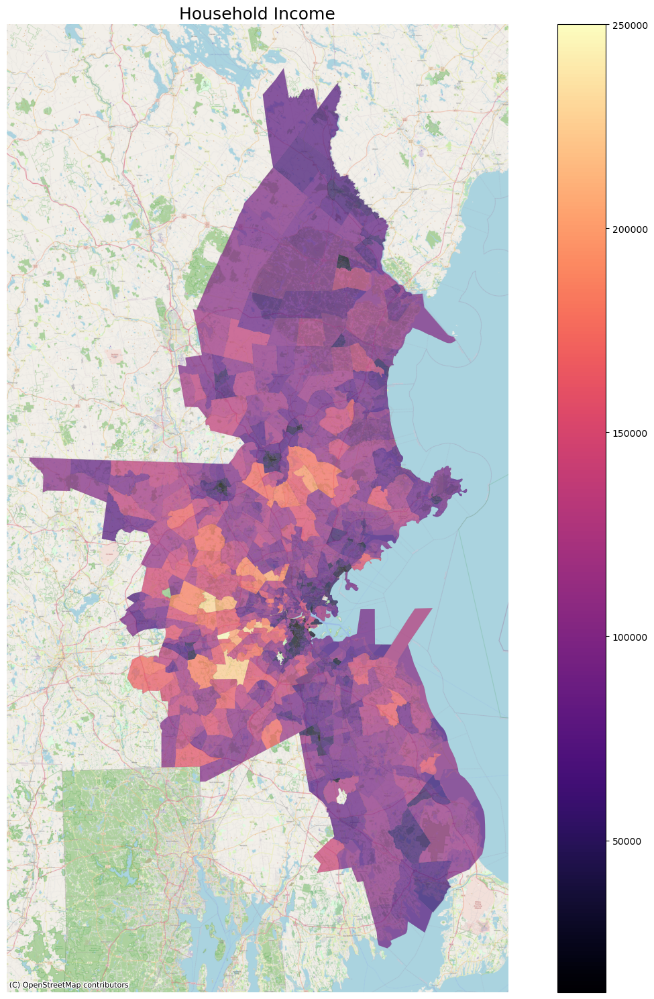

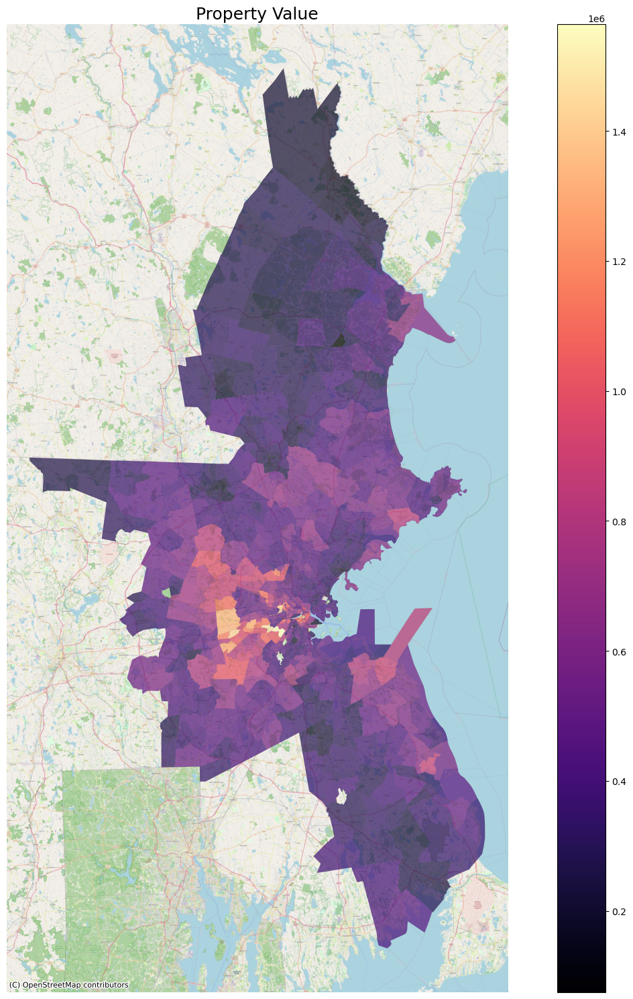

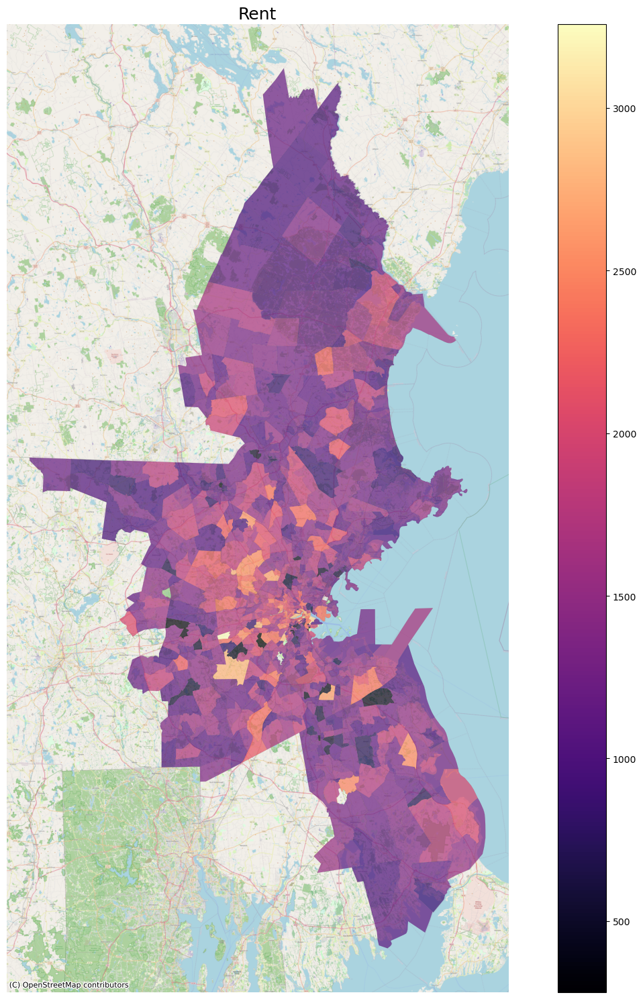

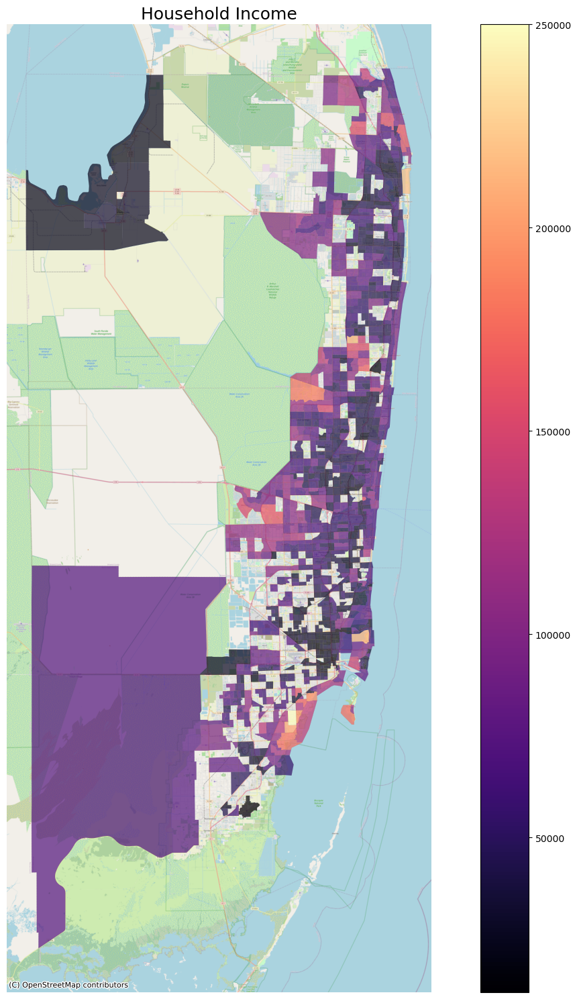

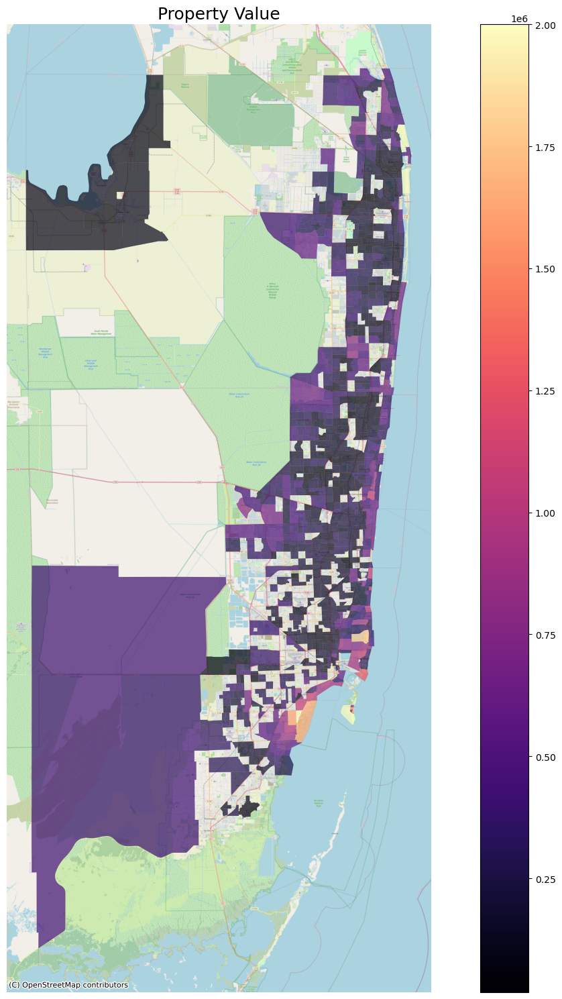

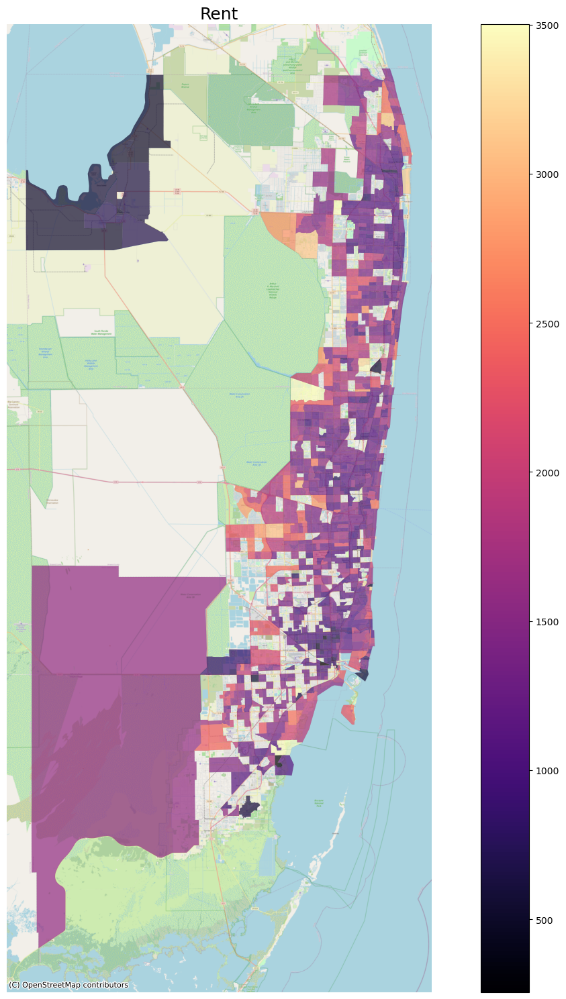

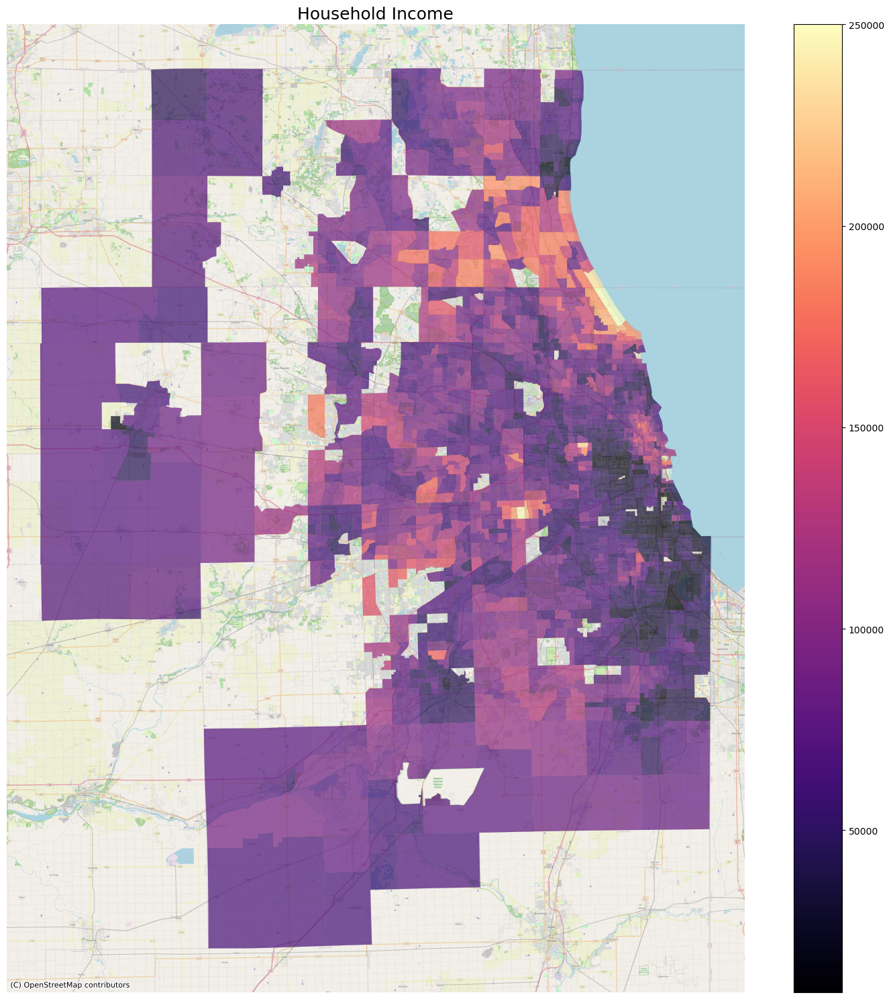

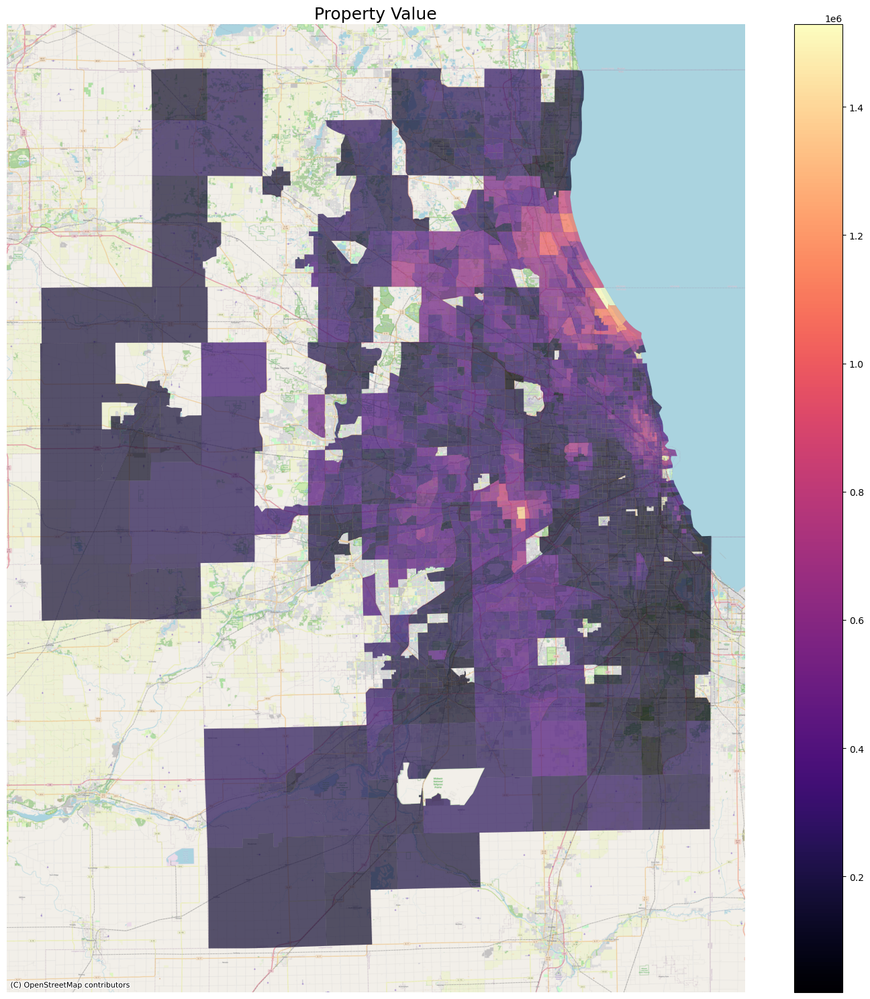

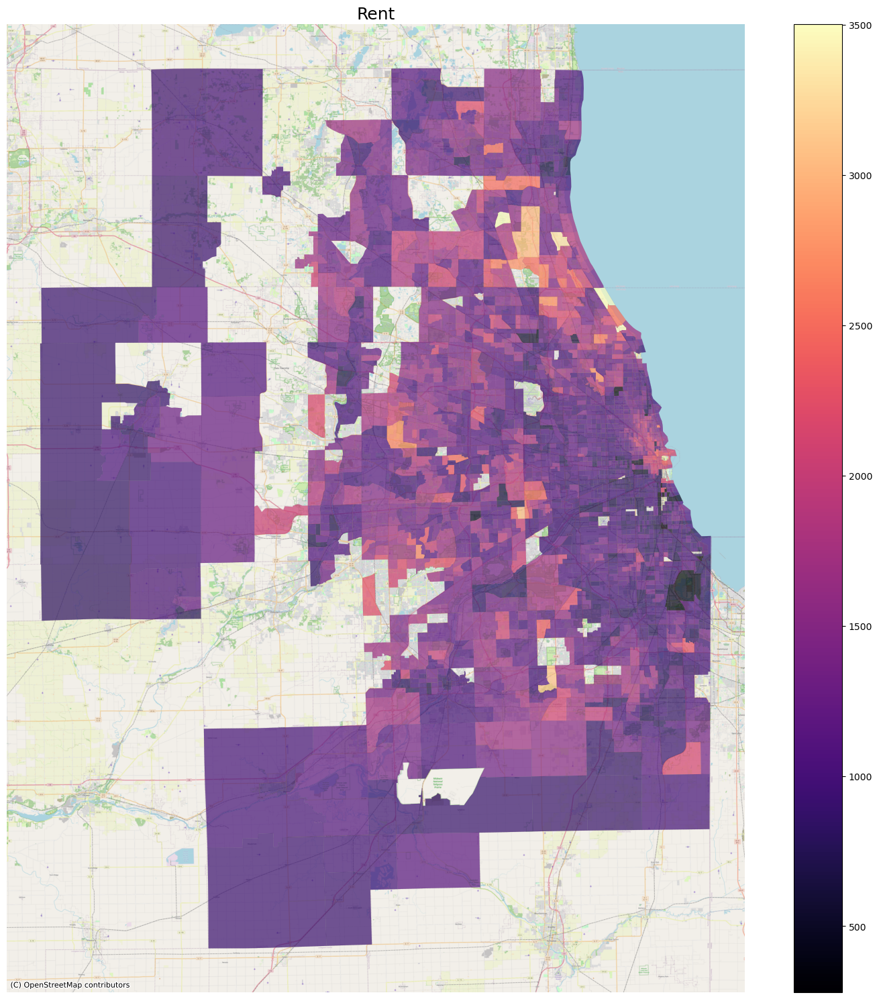

In [15]:
# 3*3 node feature visualization.
output_list = ['inc_median_household_2018', 'property_value_median_2018', 'rent_median_2018']
title_name_list = ['Household Income', 'Property Value', 'Rent']

for city in ['boston', 'miami', 'chicago']:
    for output_idx in range(3):
        output = output_list[output_idx]
        title_name = title_name_list[output_idx]
        alpha = 0.7
        fig_name = 'node_feature_' + str(city) + '_' + title_name
        utils.plot_node_with_base_map(socioecon_shp_dic[city], 
                              output, 
                              title_name, 
                              alpha, 
                              fig_name, 
                              fig_location)


### Visualizing mobility edges

- We cannot see clearly the spatial pattern. The edges are so dense. 

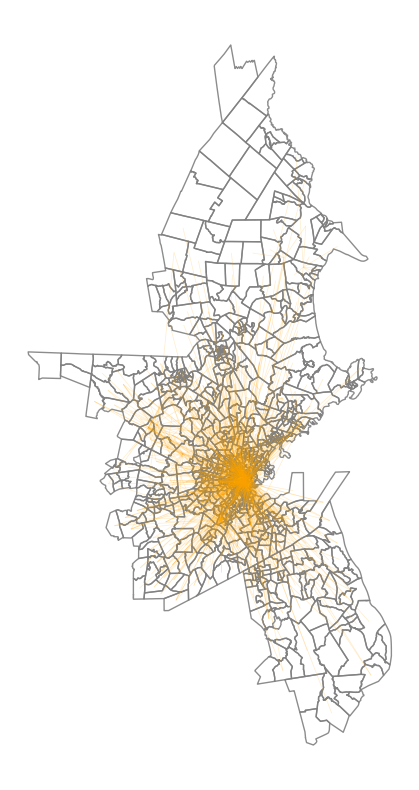

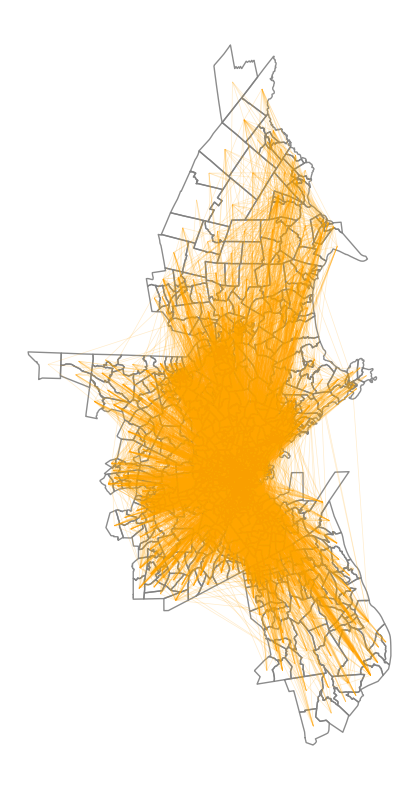

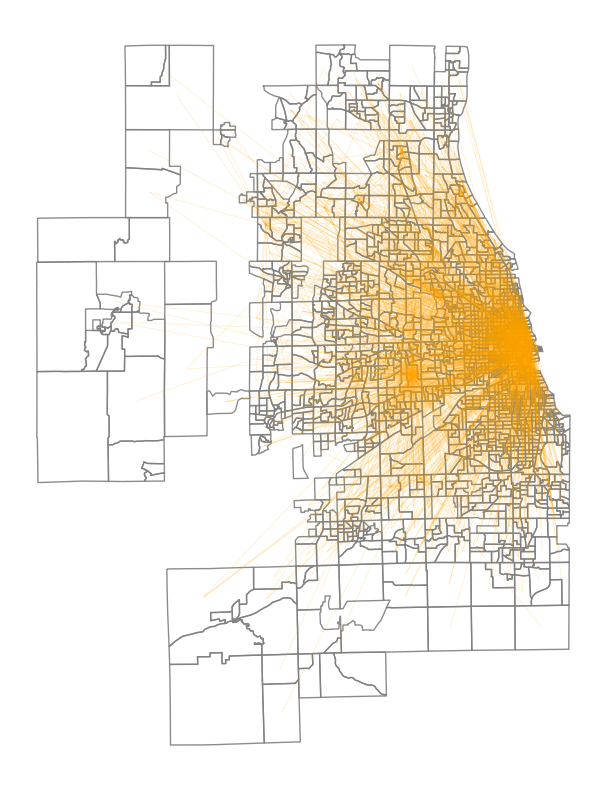

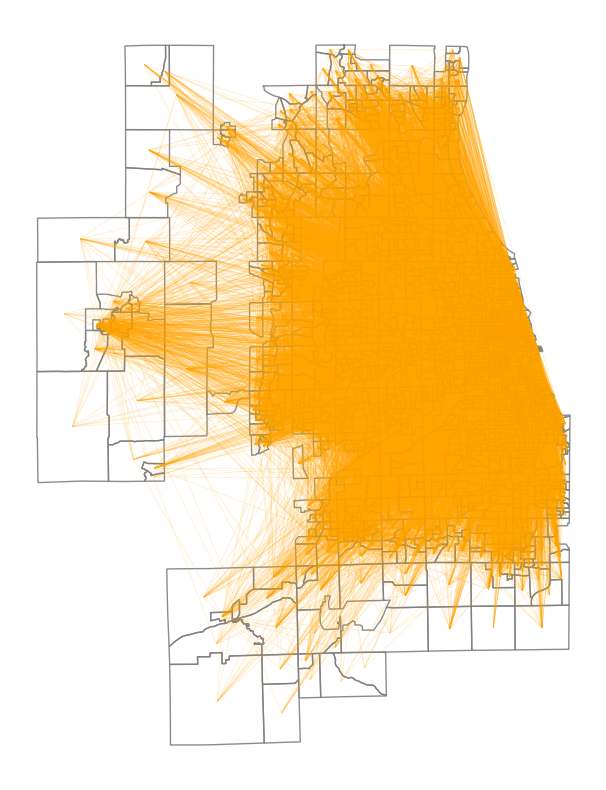

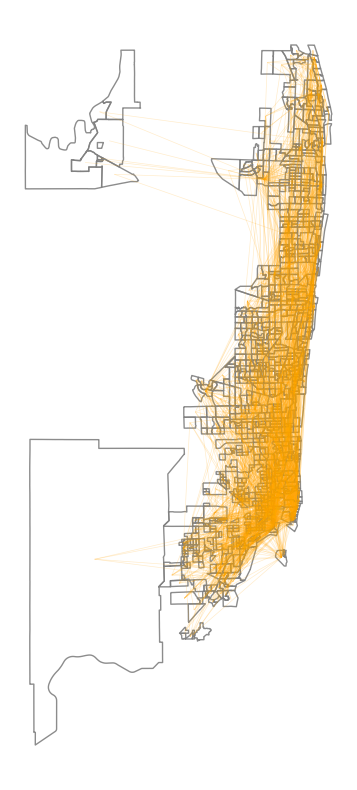

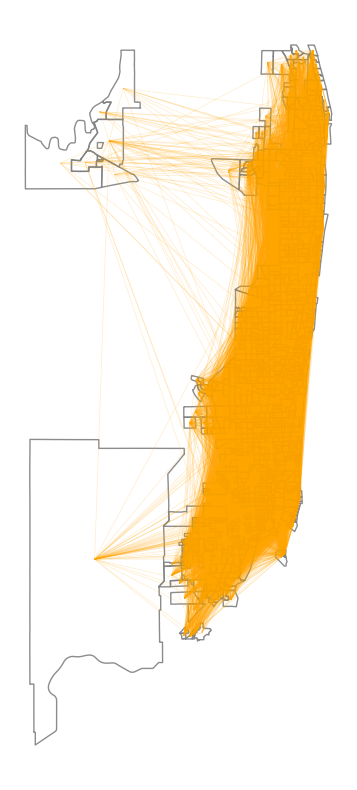

In [36]:
for city in ['boston','chicago','miami']:
    for activity_name in ['French', 'Residential']:
        
        # city = 'miami'
        # activity_name = 'French'

        G = nx.from_pandas_adjacency(A_home_unweighted_sym_dic[city][1.0][activity_name])
        G_edge_df = nx.to_pandas_edgelist(G)
        G_edge_df.index = list(zip(G_edge_df['source'], G_edge_df['target']))

        fig, ax = plt.subplots(figsize = (8, 8))
        socioecon_shp_dic[city].plot(facecolor='None', alpha = 0.9, edgecolor='grey', ax = ax)
        edge_shp_dic[city].loc[G_edge_df.index, :].plot(ax = ax, alpha = 0.2, linewidth = 0.5, color = 'orange')

        plt.axis('off')
        plt.tight_layout()
        plt.show()

        fig.savefig(fig_location+ 'mobility_net_'+ str(city) + '_' + str(activity_name) + '.png')


### Visualizing spatial edges

<Figure size 640x480 with 0 Axes>

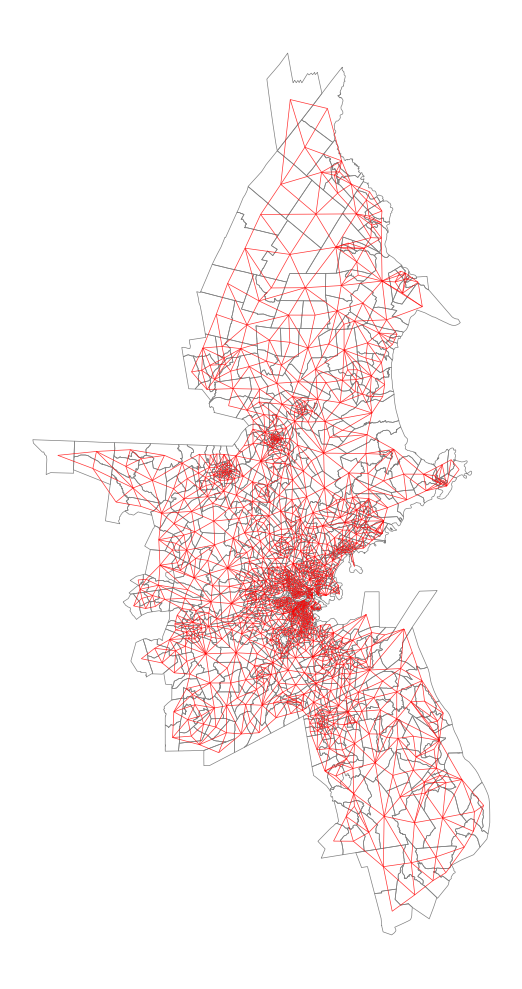

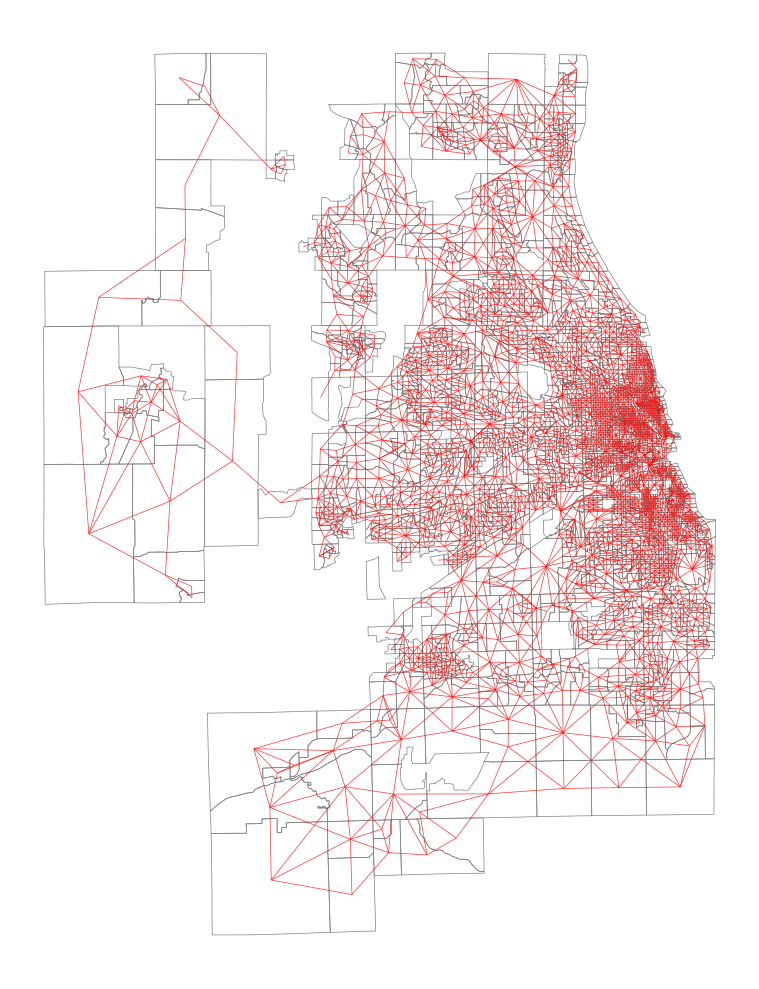

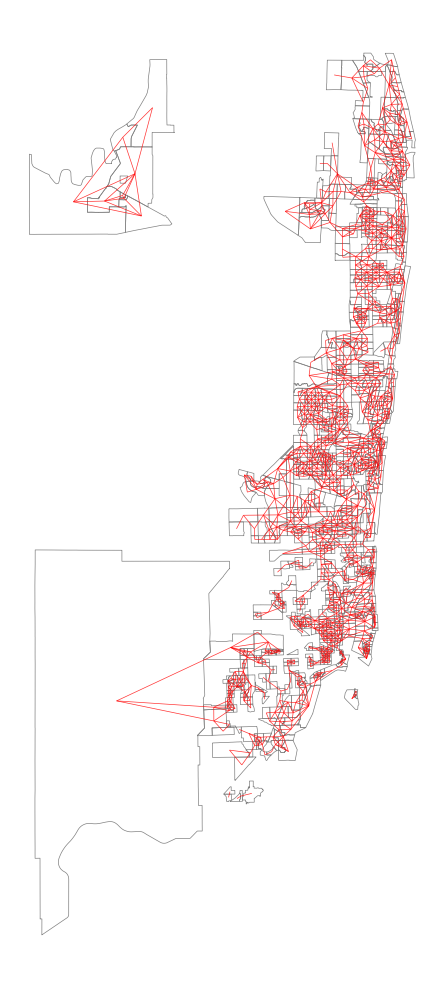

In [22]:
network_type = 'queen_contiguity_adj_df'

for city in ['boston','chicago','miami']:
    G = nx.from_pandas_adjacency(spatial_network_dic[city][network_type])
    G_edge_df = nx.to_pandas_edgelist(G)
    G_edge_df.index = list(zip(G_edge_df['source'], G_edge_df['target']))

    # visualize the edge df
    fig, ax = plt.subplots(figsize = (10, 10))
    socioecon_shp_dic[city].plot(facecolor='None', edgecolor='grey', ax = ax, linewidth = 0.5)
    edge_shp_dic[city].loc[G_edge_df.index, :].plot(ax = ax, alpha = 0.8, linewidth = 0.5, color = 'red')

    plt.axis('off')
    plt.tight_layout()

    plt.show()
    fig.savefig(fig_location+ 'spatial_net_'+ str(city) + '.png')
